Notebook to run inference on video files using yolov8s finetuned on manually labeled data

In [1]:
!pip install ultralytics
!pip install supervision==0.24.0
!pip install PyYAML

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 982.4/982.4 kB 58.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 125.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 97.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 44.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 20.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 104.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninst

In [4]:
!cp "/content/drive/MyDrive/Walmart_AI_Project/vid_test.zip" "/content/"

In [ ]:
!unzip /content/roboflow_yolov8s_model.zip -d /content/

Archive:  /content/roboflow_yolov8s_model.zip
   creating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/
  inflating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/P_curve.png  
  inflating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/results.csv  
  inflating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/labels_correlogram.jpg  
  inflating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/PR_curve.png  
  inflating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/labels.jpg  
  inflating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/F1_curve.png  
  inflating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/confusion_matrix.png  
   creating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/weights/
  inflating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/weights/best.pt  
  inflating: /content/content/runs/detect/roboflow_dataset_yolov8s_train/weig

In [5]:
#!unzip /content/hard_test.zip -d /content/
!unzip /content/vid_test.zip -d /content/

Archive:  /content/vid_test.zip
   creating: /content/vid_test/
  inflating: /content/vid_test/test1.mp4  
  inflating: /content/vid_test/test2.mp4  
  inflating: /content/vid_test/test3.mp4  
  inflating: /content/vid_test/test4.mp4  
  inflating: /content/vid_test/test5.mp4  


In [6]:
!cp "/content/drive/MyDrive/Walmart_AI_Project/testing_set_roboflow.zip" "/content/"

In [7]:
!unzip /content/testing_set_roboflow.zip -d /content/

Archive:  /content/testing_set_roboflow.zip
   creating: /content/testing_set_roboflow/
  inflating: /content/testing_set_roboflow/APPLES_MD_100.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_101.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_102.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_104.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_106.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_107.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_108.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_110.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_112.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_113.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_114.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_115.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_116.jpg  
  inflating: /content/testing_set_roboflow/APPLES_MD_117.jpg  
  inflating: /content/testing_

In [ ]:
!rm -rf /content/dataset2/

Test on images

In [8]:
# Load best weights
model_weights = "/content/finetune2/best.pt"

# Test images
test_images = "/content/testing_set_roboflow"

# Evaluate on test images
!yolo predict \
  model="{model_weights}" \
  source="{test_images}" \
  save=True \
  device=0 \
  name="roboflow_dataset_yolov8s_test_predictions"
  # conf=0.4 # Conf threshold


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.113 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
Model summary (fused): 72 layers, 11,128,293 parameters, 0 gradients, 28.5 GFLOPs

image 1/320 /content/testing_set_roboflow/APPLES_MD_100.jpg: 640x480 2 APPLESs, 74.2ms
image 2/320 /content/testing_set_roboflow/APPLES_MD_101.jpg: 640x480 2 APPLESs, 7.6ms
image 3/320 /content/testing_set_roboflow/APPLES_MD_102.jpg: 640x480 2 APPLESs, 1 TOMATOES, 7.5ms
image 4/320 /content/testing_set_roboflow/APPLES_MD_104.jpg: 640x480 2 APPLESs, 7.5ms
image 5/320 /content/testing_set_roboflow/APPLES_MD_106.jpg: 640x480 2 APPLESs, 7.5ms
image 6/320 /content/testing_set_roboflow/APPLES_MD_107.jpg: 640x480 2 APPLESs,

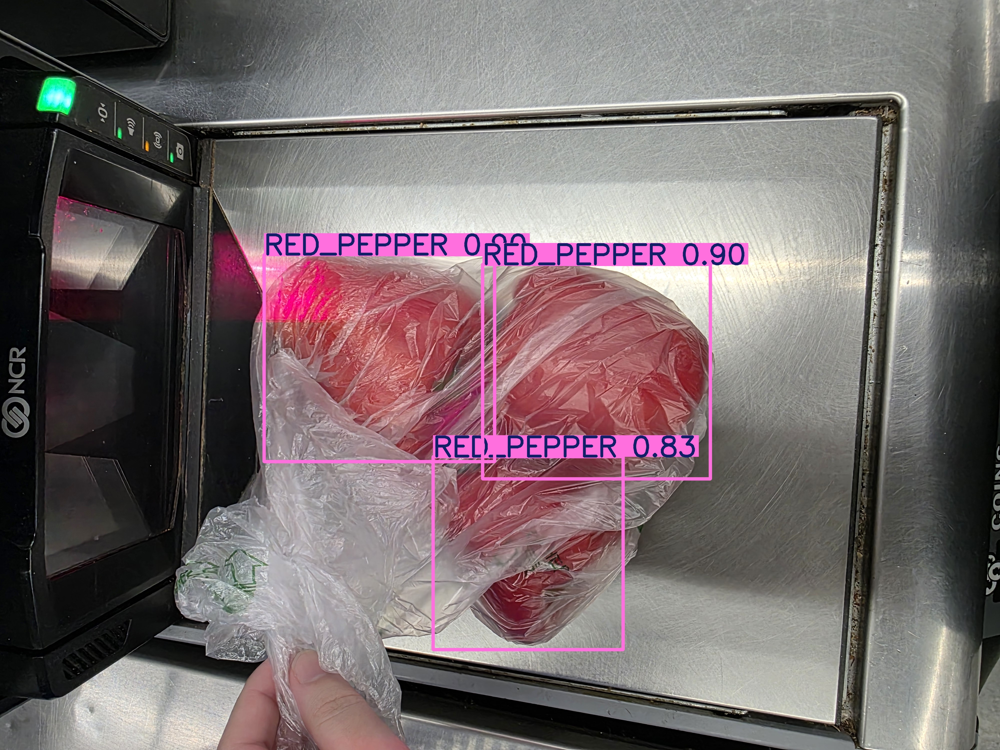

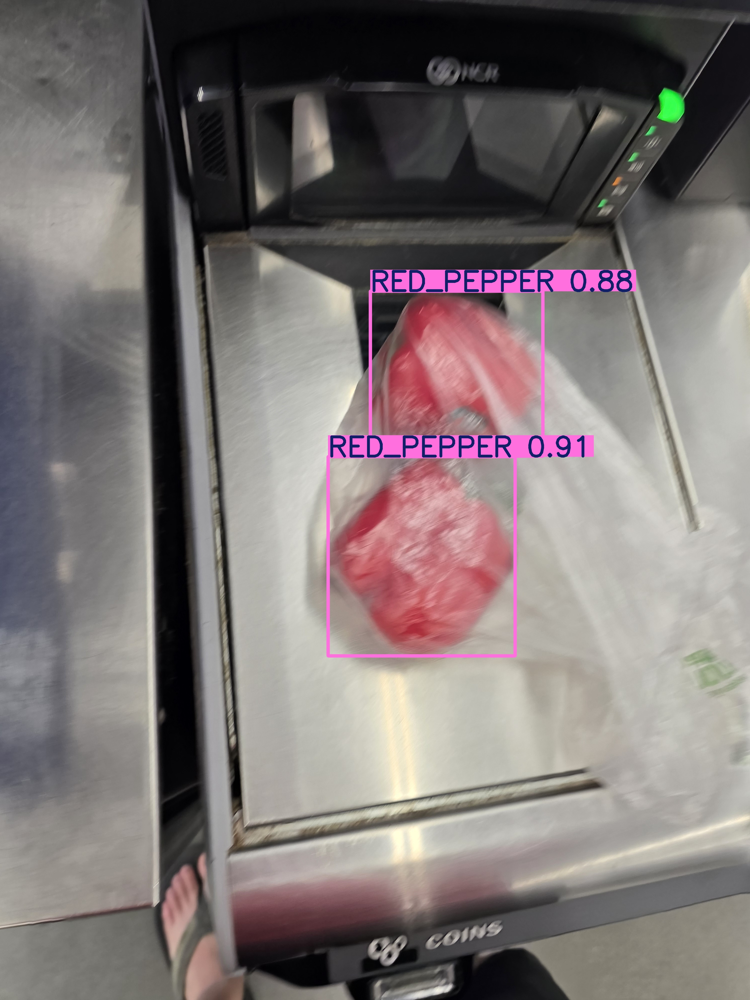

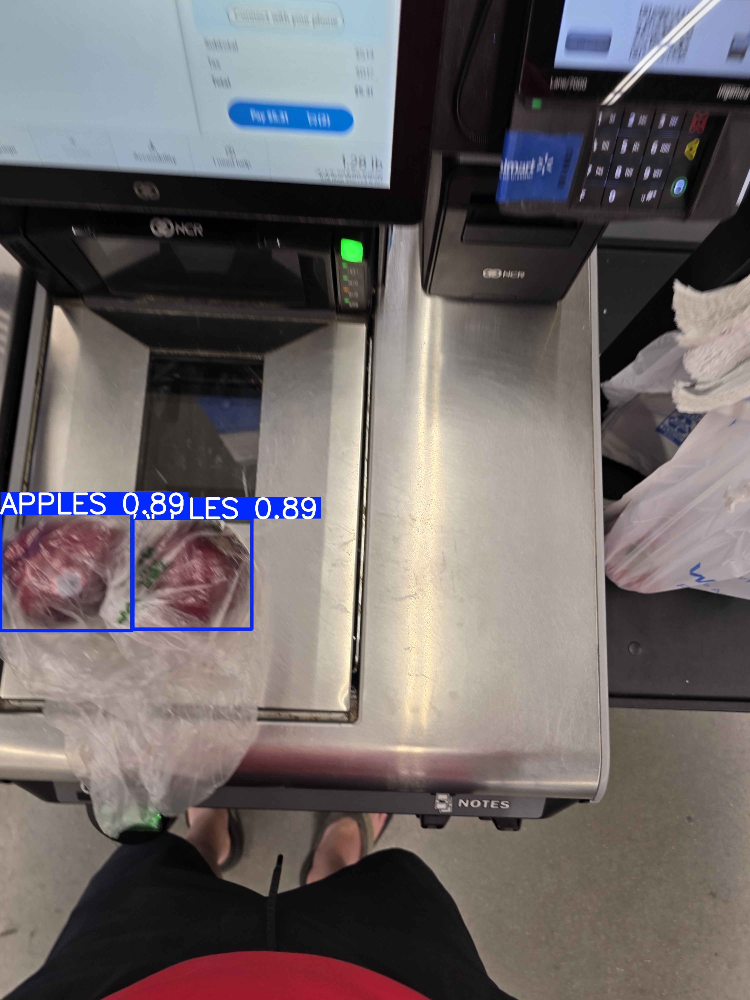

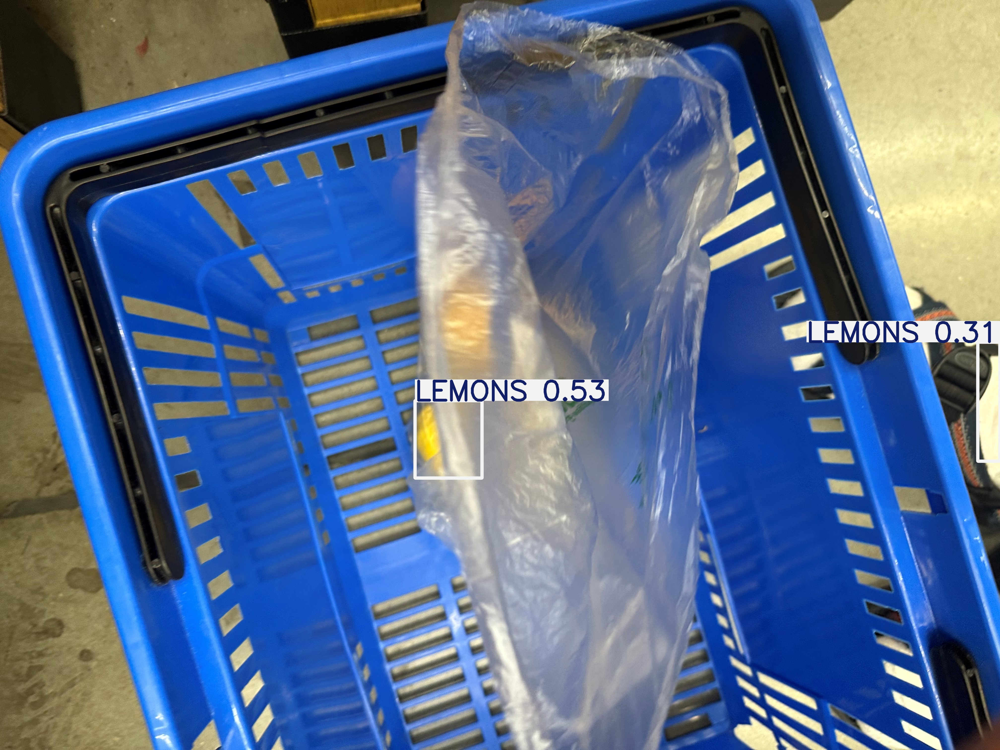

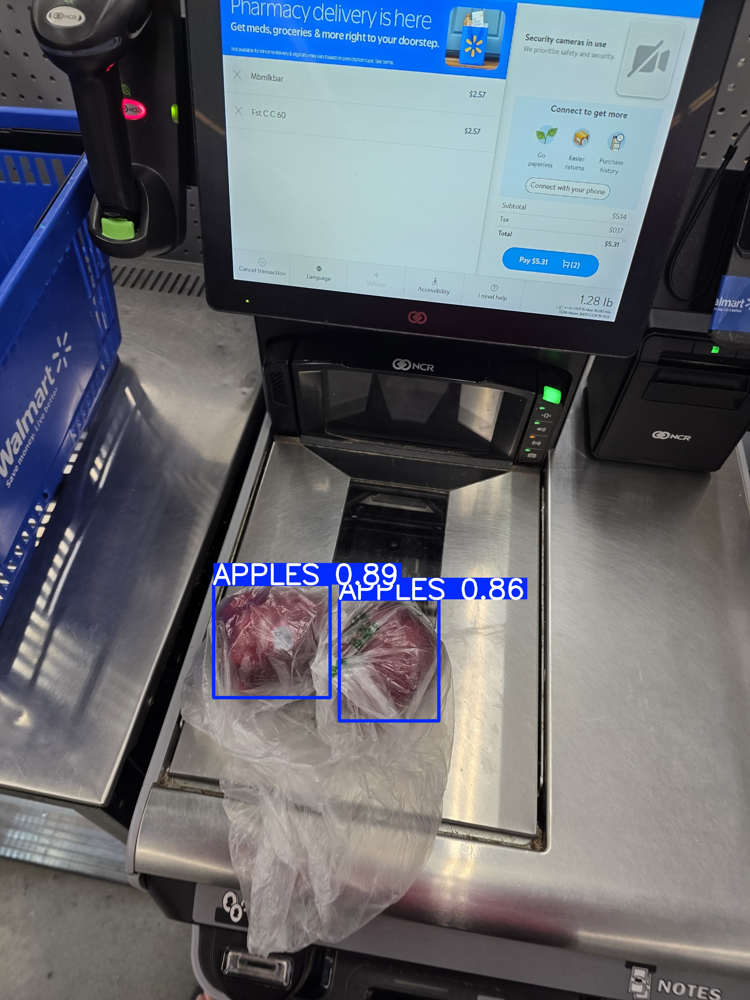

...

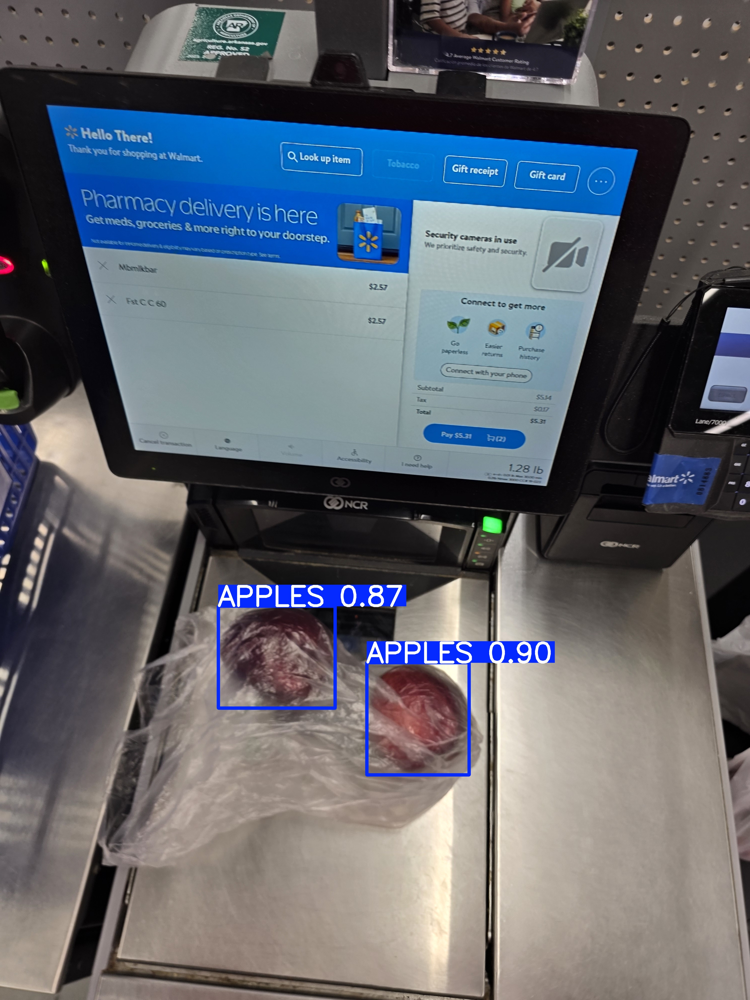

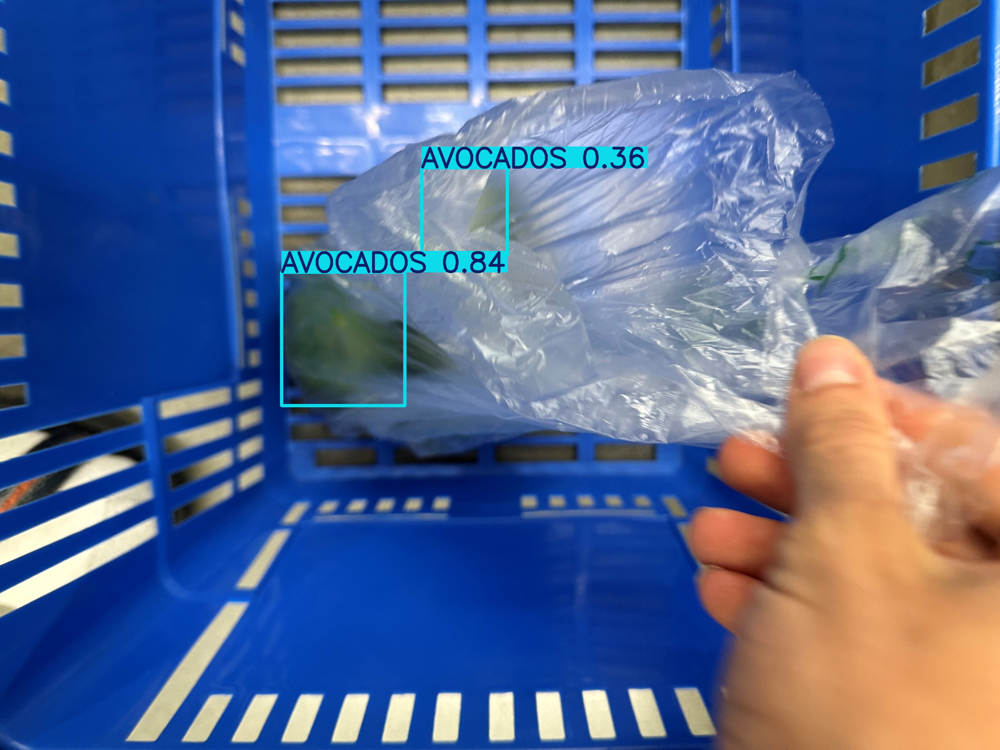

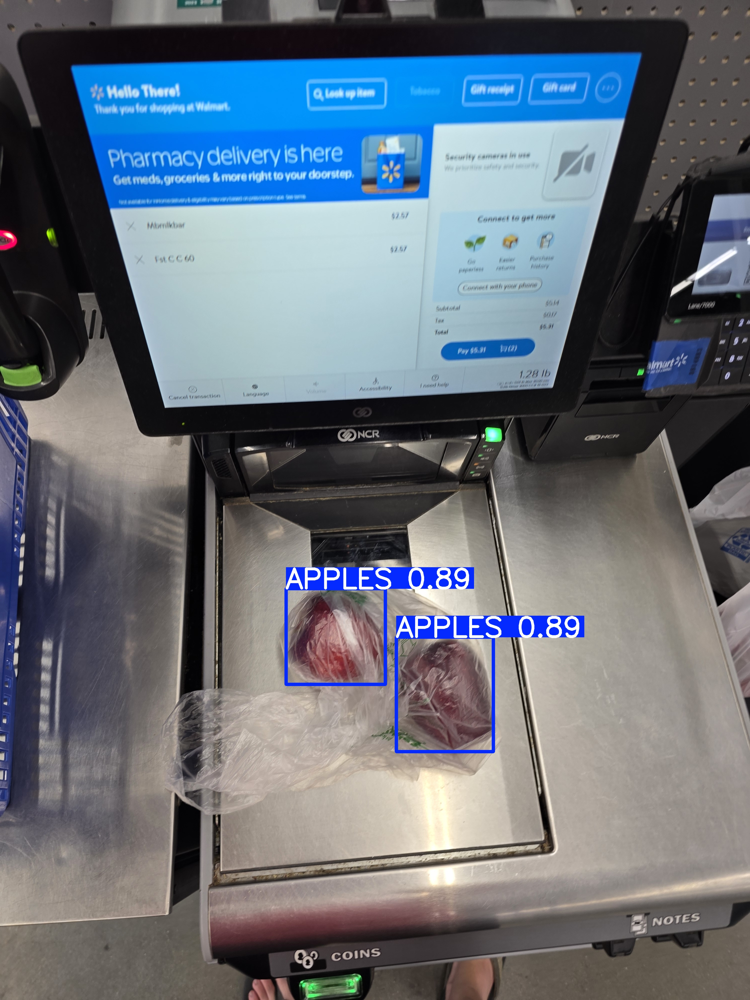

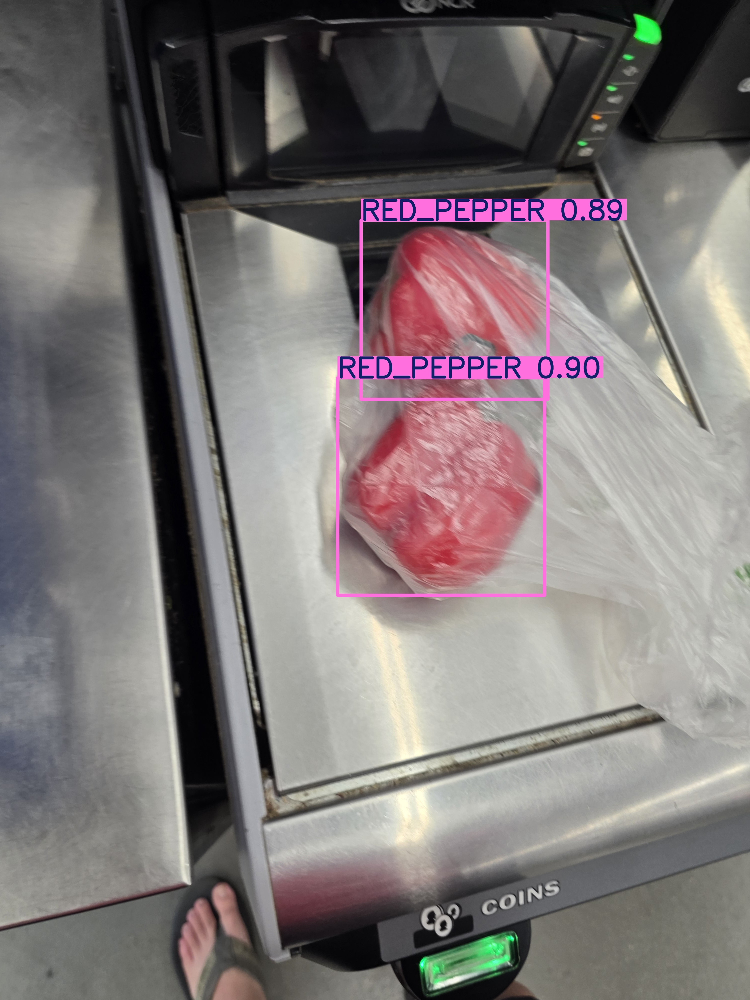

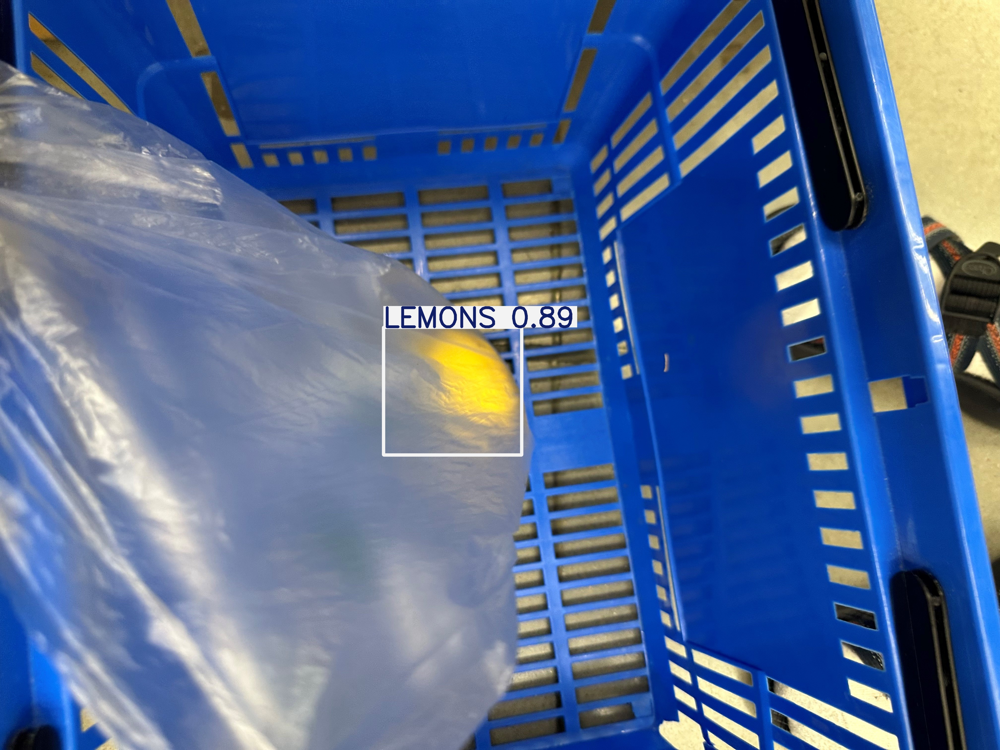

In [9]:
import os
from IPython.display import Image, display
test_img_run = "/content/runs/detect/roboflow_dataset_yolov8s_test_predictions"
# Get all files in test image directory
tested_images = [f for f in os.listdir(test_img_run)]
count = 0
for img in tested_images:
  count+=1
  display(Image(filename=os.path.join(test_img_run, img)))
  if count > 10:
    break

Test on video, need a lot of system ram if running on videos longer than 1 minute (>30GB system ram)

In [18]:
from ultralytics import YOLO

model_weights = "/content/finetune2/best.pt"

model = YOLO(model_weights)

video_path = "/content/vid_test/test3.mp4"

# Higher is stricter
confidence_threshold = 0.4

# For overlapping boxes/detections, lower is stricter
iou_threshold = 0.5

print(f"Running YOLOv8 prediction on: {video_path}")
results = model.predict(
    source=video_path,
    stream=False,
    save=True,         # saves an annotated video
    conf=confidence_threshold,
    iou=iou_threshold,
    # classes=[0, 3]  # Filter for specific class IDs
    # vid_stride=process_every_n_frame # Process every Nth frame
    # save_txt=True    # Save results to .txt files
    # save_conf=True   # Include confidence in .txt files
)


Running YOLOv8 prediction on: /content/vid_test/test3.mp4

WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/3109) /content/vid_test/test3.mp4: 384x640 1 LIMES, 9.0ms
video 1/1 (frame 2/3109) /content/vid_test/test3.mp4: 384x640 1 LIMES, 8.1ms
video 1/1 (frame 3/3109) /content/vid_test/test3.mp4: 384x640 1 LIMES, 8.0ms
video 1/1 (frame 4/3109) /content/vid_test/test3.mp4: 384x640 1 LIMES, 12.6ms
video 1/1 (frame 5/3109) /content/vid_test/test3.mp4: 384x640 1 LIMES, 8.4ms
video 1/1 (f

Convert .avi to .mp4 using FFmpeg

In [19]:
avi_path = "/content/runs/detect/predict3/test3.avi"
output_mp4_path = "/content/test3.mp4"

# FFmpeg command configs
# -i : Input file
# -c:v libx264 : Set video codec to H.264 (MP4)
# -crf 23 : Constant Rate Factor (quality level, lower=better quality/larger file, 23 is a good default)
# -preset medium : Encoding speed vs compression tradeoff (medium is balanced)
# -pix_fmt yuv420p : Pixel format for broad compatibility
# -c:a aac : Set audio codec to AAC
# -b:a 128k : Set audio bitrate
# -y : Overwrite output file without asking
ffmpeg_command = f'ffmpeg -i "{avi_path}" -c:v libx264 -crf 23 -preset medium -pix_fmt yuv420p -c:a aac -b:a 128k -y "{output_mp4_path}"'

print(f"Running command: {ffmpeg_command}")

!{ffmpeg_command}

Running command: ffmpeg -i "/content/runs/detect/predict3/test3.avi" -c:v libx264 -crf 23 -preset medium -pix_fmt yuv420p -c:a aac -b:a 128k -y "/content/test3.mp4"
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --

In [ ]:
!zip -r roboflow_yolov8s_model.zip "/content/runs/detect/roboflow_dataset_yolov8s_train"

from google.colab import files
files.download('roboflow_yolov8s_model.zip')

  adding: content/runs/detect/roboflow_dataset_yolov8s_train/ (stored 0%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/P_curve.png (deflated 15%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/results.csv (deflated 61%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/labels_correlogram.jpg (deflated 41%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/PR_curve.png (deflated 17%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/labels.jpg (deflated 32%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/F1_curve.png (deflated 13%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/confusion_matrix.png (deflated 29%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/weights/ (stored 0%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/weights/best.pt (deflated 8%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/weights/last.pt (deflated 8%)
  adding: content/runs/de

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [20]:
!zip -r roboflow_finetune2_Full_test.zip "/content/runs/detect/roboflow_dataset_yolov8s_test_predictions"

from google.colab import files
files.download('roboflow_finetune2_Full_test.zip')

  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/ (stored 0%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/REDPEPPER_MD_103.jpg (deflated 1%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/REDPEPPER_MD_28.jpg (deflated 1%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/APPLES_MD_127.jpg (deflated 1%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/LEMON_CART_HD_16.jpg (deflated 3%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/APPLES_MD_132.jpg (deflated 1%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/APPLES_MD_59.jpg (deflated 1%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/APPLES_MD_69.jpg (deflated 1%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/AVOCADO_CART_HD_1.jpg (deflated 3%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/A

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import files
files.download('roboflow_test2.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [21]:
files.download('test3.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>